In [1]:
import numpy as np
import matplotlib.pyplot as plt
import cv2

In [2]:
def imshows(images, titles=[], size=None, clean=False, suptitle=''):
    """Show images, with titles (optional)"""

    assert isinstance(images, list), 'Images must be list'
    assert isinstance(titles, list), 'Titles must be list'
    assert len(images) != 1, 'Use imshow() instead'
    if size:
        try:
            assert isinstance(size, list) or isinstance(size, tuple)
            assert len(size) == 2
            assert len(images) == size[0] * size[1]
        except:
            raise AssertionError('Invalid size')

    if size:
        fig, axes = plt.subplots(
            size[0], size[1], figsize=(size[1]*8, size[0]*5)
        )
    else: 
        fig, axes = plt.subplots(1, len(images), figsize=(15,15))
        for i, image in enumerate(images):
            if(len(image.shape) == 3):
                axes[i].imshow(image)
            else:
                axes[i].imshow(image, plt.cm.gray)
            if titles:
                axes[i].set_title(titles[i])

    for i, (ax, image) in enumerate(zip(axes.flatten(), images)):
        if(len(image.shape) == 3):
            ax.imshow(image)
        else:
            ax.imshow(image, plt.cm.gray)
        if titles:
            ax.set_title(titles[i])
        if clean:
            ax.set_xticks([])
            ax.set_yticks([])
    if suptitle:
        plt.suptitle(suptitle)

    plt.show()

def imshow(image, title=''):
    """Show image, with title (optional)"""

    if(len(image.shape) == 3):
        plt.imshow(image)
    else:
        plt.imshow(image, plt.cm.gray)
    if title:
        plt.title(title)

    plt.show()

def gray(image):
    """Return grayscale image"""
    
    return cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)

def hsv(image):
    """Return HSV image"""

    return cv2.cvtColor(image, cv2.COLOR_RGB2HSV)

# Bài 1

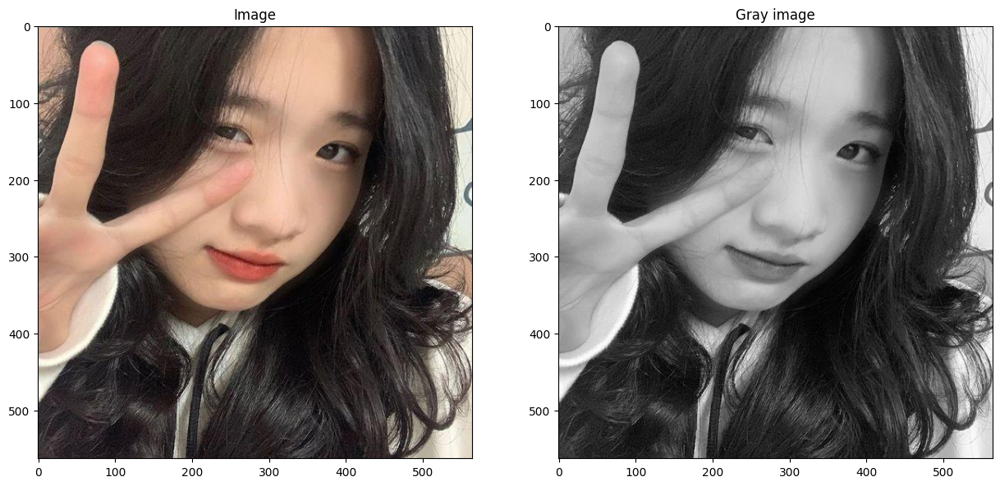

In [3]:
img = plt.imread('images/girl5.jpg')
img_gray = gray(img)
imshows([img, img_gray], titles=['Image', 'Gray image'])

In [4]:
def dft_transform(img, return_shift=False):
    dft = cv2.dft(np.float32(img), flags=cv2.DFT_COMPLEX_OUTPUT)
    dft_shift = np.fft.fftshift(dft)
    magnitude_spectrum = 20 * np.log(
        cv2.magnitude(dft_shift[:, :, 0], dft_shift[:, :, 1])
    )
    if return_shift:
        return dft_shift, magnitude_spectrum
    return magnitude_spectrum

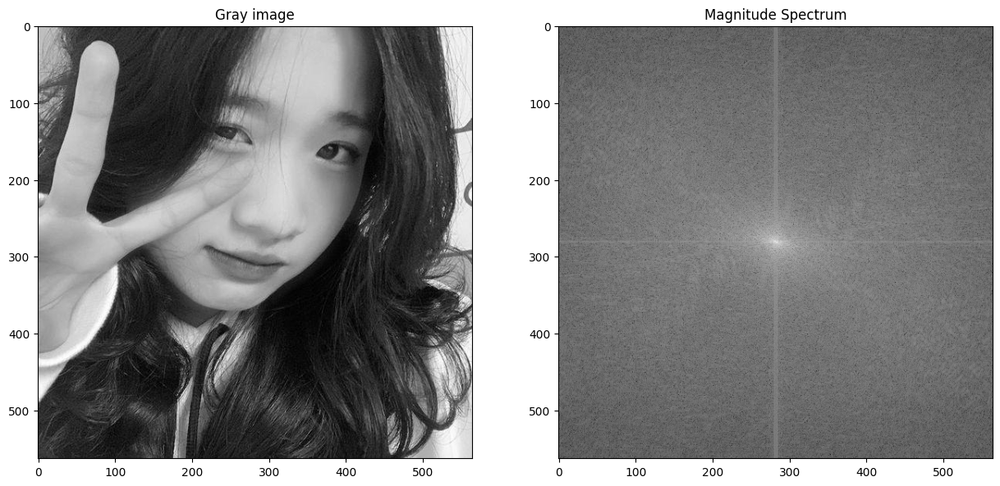

In [5]:
imshows(
    [img_gray, dft_transform(img_gray)], 
    titles=['Gray image', 'Magnitude Spectrum']
)

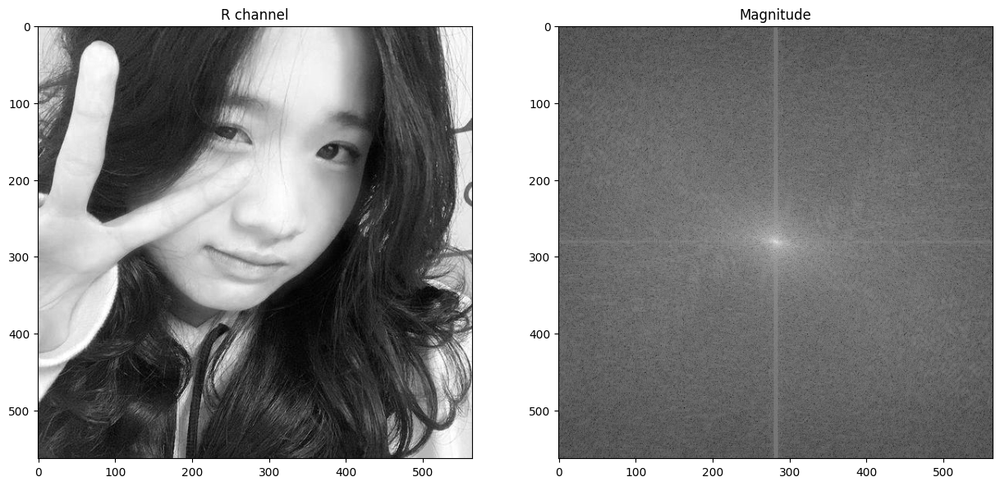

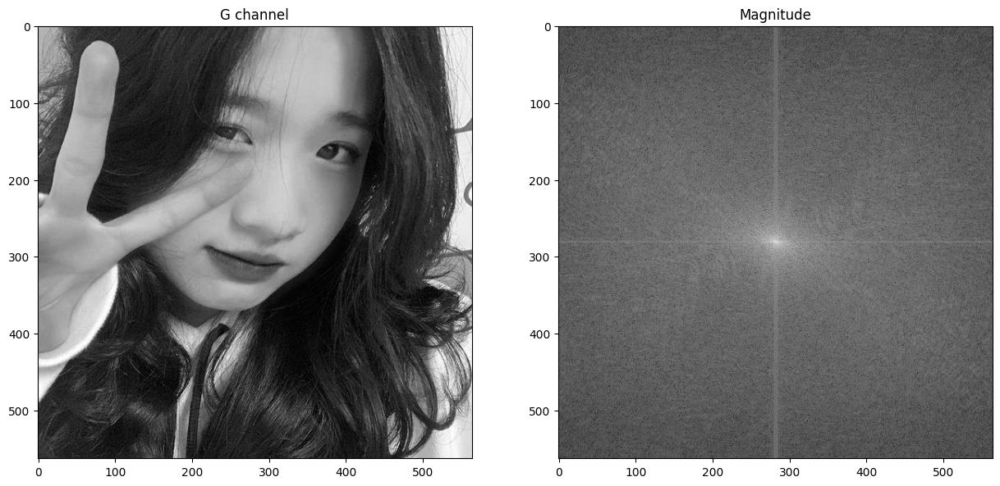

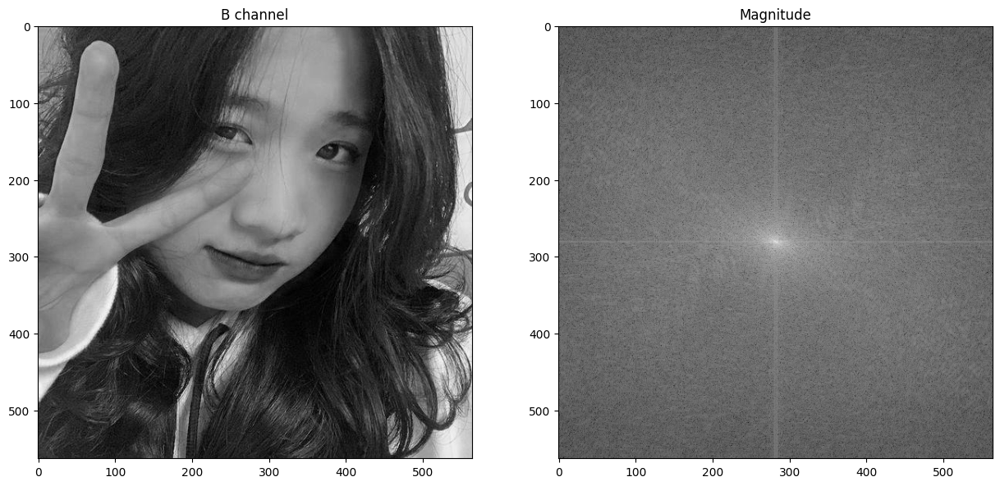

In [6]:
R, G, B = cv2.split(img)
imshows([R, dft_transform(R)], titles=['R channel', 'Magnitude'])
imshows([G, dft_transform(G)], titles=['G channel', 'Magnitude'])
imshows([B, dft_transform(B)], titles=['B channel', 'Magnitude'])

## DFT for noised and blurred image

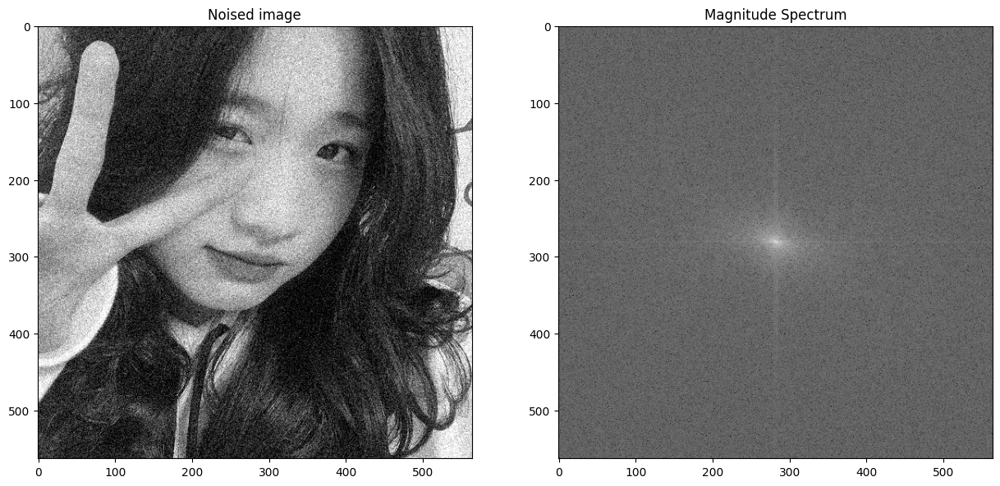

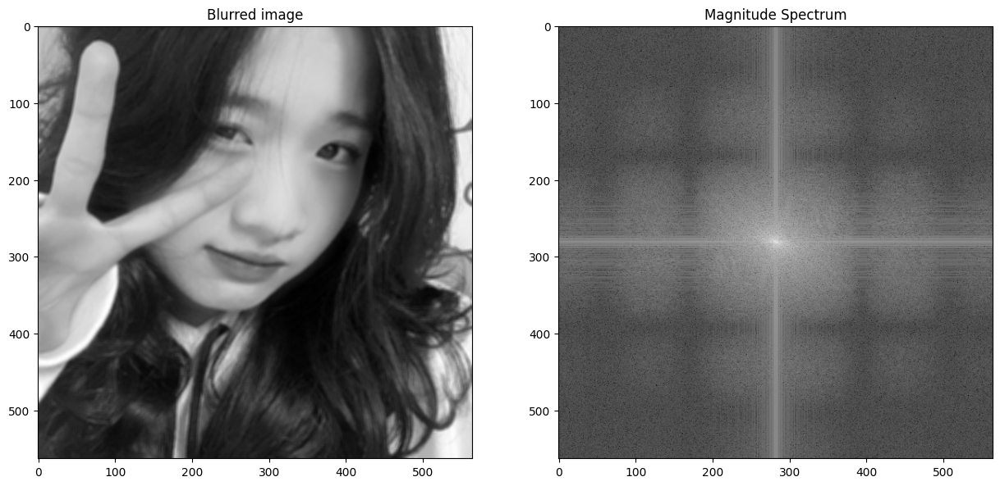

In [7]:
from skimage.util import random_noise
img_noised = random_noise(img_gray)
imshows(
    [img_noised, dft_transform(img_noised)], 
    titles=['Noised image', 'Magnitude Spectrum']
)

blurred = cv2.blur(img_gray, (5,5))
imshows(
    [blurred, dft_transform(blurred)], 
    titles=['Blurred image', 'Magnitude Spectrum']
)

## Tạo ảnh mask để bỏ miền tần số cao và hiển thị ảnh texture 

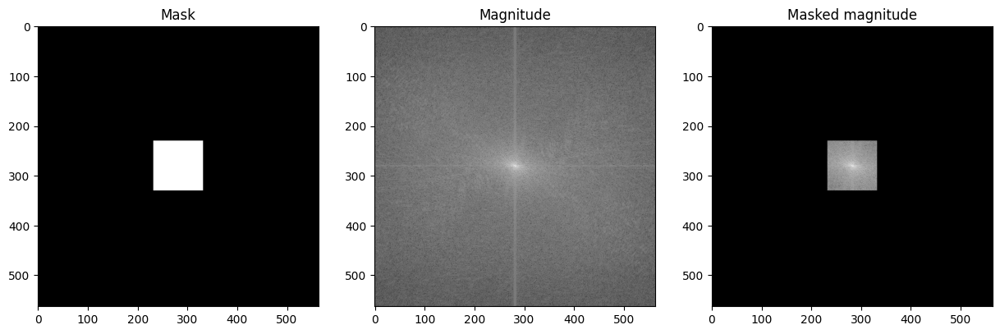

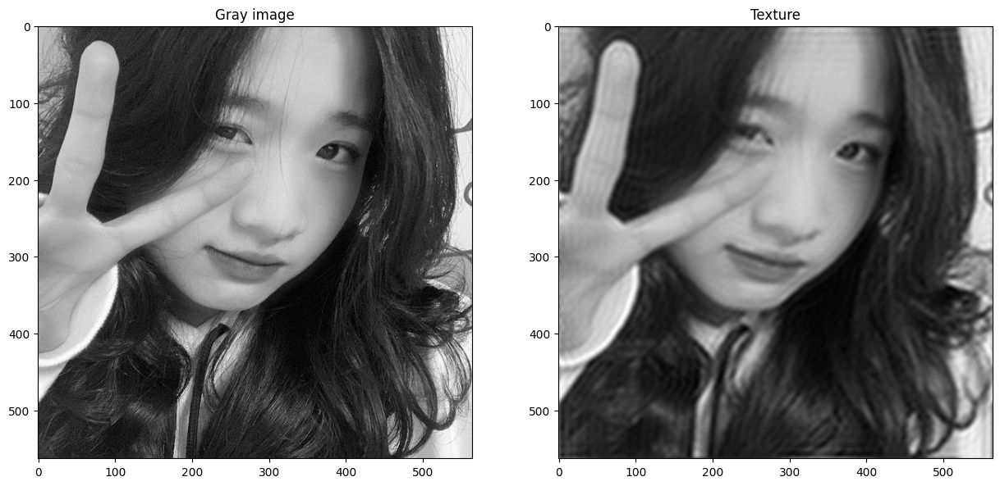

In [8]:
dft_shift, img_dft_frequency = dft_transform(img_gray, return_shift=True)

rows, cols = img_gray.shape
center_row, center_col = rows//2, cols//2

# Create mask
mask = np.zeros((rows, cols, 2), np.uint8)
size = 50
mask[center_row-size:center_row+size, center_col-size:center_col+size] = 1

img_dft_frequency_masked = img_dft_frequency * mask[:,:,0]

# Apply mask and inverse DFT
fshift = dft_shift * mask
f_ishift = np.fft.ifftshift(fshift)
inverse = cv2.idft(f_ishift)
img_inverse = cv2.magnitude(inverse[:,:,0], inverse[:,:,1])

imshows([mask[:,:,0], img_dft_frequency, img_dft_frequency_masked],
        titles=['Mask', 'Magnitude', 'Masked magnitude'])

imshows([img_gray, img_inverse], titles=['Gray image', 'Texture'])

## Tạo ảnh mask để bỏ miền tần số thấp và hiển thị ảnh edge

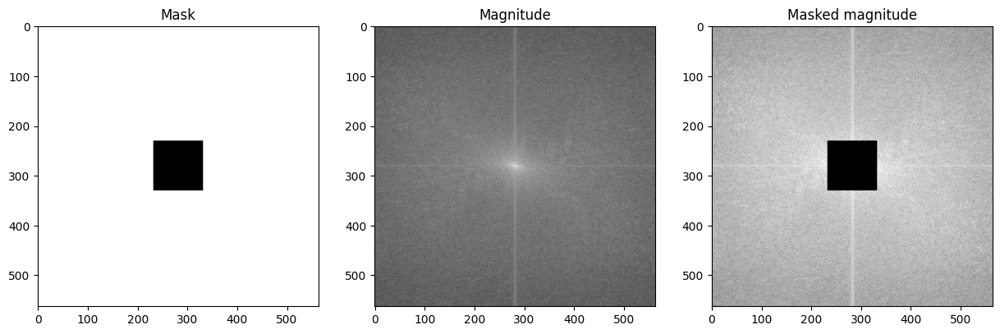

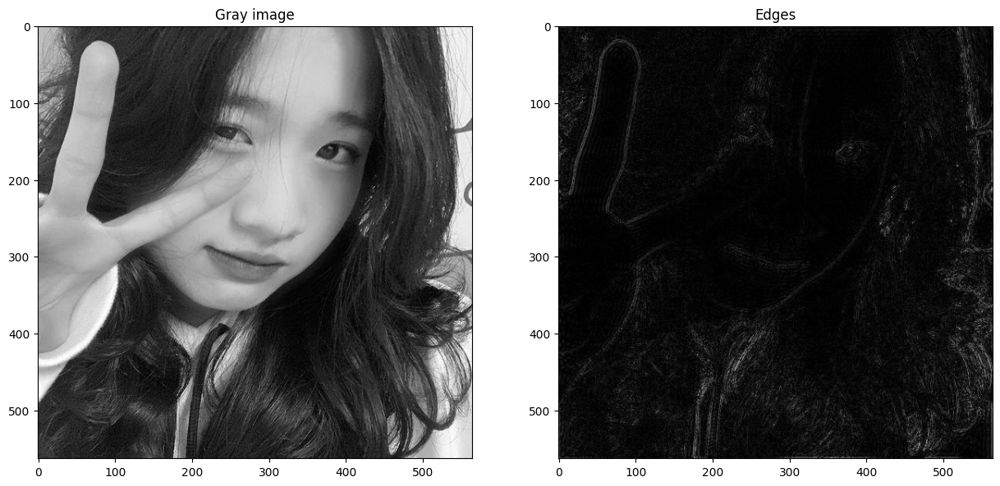

In [9]:
dft_shift, img_dft_frequency = dft_transform(img_gray, return_shift=True)

rows, cols = img_gray.shape
center_row, center_col = rows//2, cols//2

# Create mask
mask = np.zeros((rows, cols, 2), np.uint8)
size = 50
mask[center_row-size:center_row+size, center_col-size:center_col+size] = 1
mask = 1 - mask

img_dft_frequency_masked = img_dft_frequency * mask[:,:,0]

# Apply mask and inverse DFT
fshift = dft_shift * mask
f_ishift = np.fft.ifftshift(fshift)
inverse = cv2.idft(f_ishift)
img_inverse = cv2.magnitude(inverse[:,:,0], inverse[:,:,1])

imshows([mask[:,:,0], img_dft_frequency, img_dft_frequency_masked],
        titles=['Mask', 'Magnitude', 'Masked magnitude'])

imshows([img_gray, img_inverse], titles=['Gray image', 'Edges'])

## Tạo ảnh mask như sau và thực hiện thay đổi miền tần số sau đó xuất ảnh kết quả 

Vì ảnh DFT của ảnh này không có đường chéo nào nên ta không mask theo kiểu đường chéo mà ta mask theo đường ngang

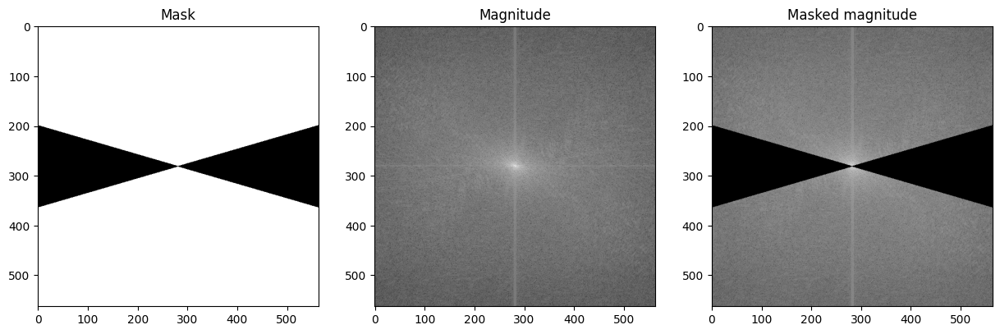

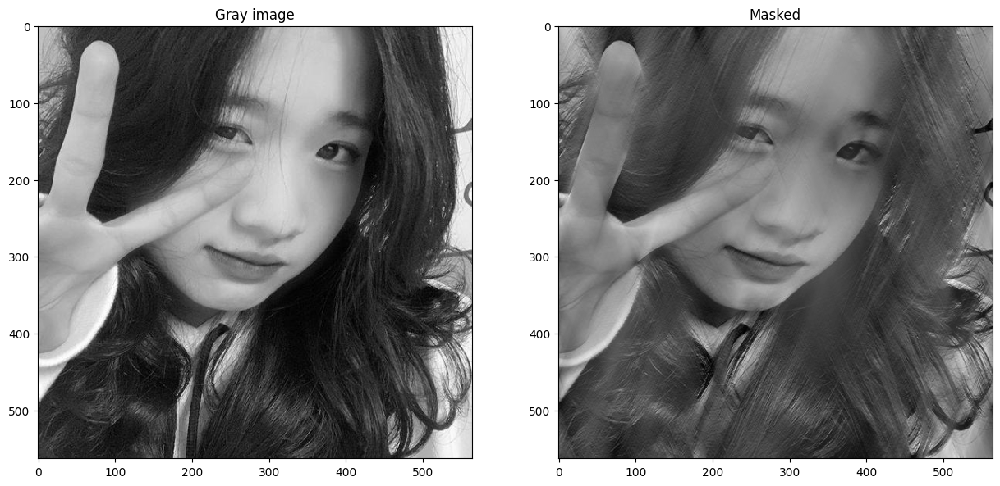

In [10]:
color_white = (255, 255, 255)

# Create mask
rows, cols = img_gray.shape[:2]
center = (rows//2, cols//2)
mask = np.zeros((rows, cols, 2), dtype=np.uint8)

# Draw two lines to form two triangles
size = 200
cv2.line(mask, (0, 0 + size), (rows, cols - size), color_white, 1)
cv2.line(mask, (0, cols - size), (rows, 0 + size), color_white, 1)

# Fill two triangles
# Left triangle
pts = np.array([[0, 0 + size], center, [0, cols - size]], np.int32)
pts = pts.reshape((-1, 1, 2))
cv2.fillPoly(mask, [pts], color=color_white)
# Right triangle
pts = np.array([[rows, 0 + size], center, [rows, cols - size]], np.int32)
pts = pts.reshape((-1, 1, 2))
cv2.fillPoly(mask, [pts], color=color_white)

# Thresholding to create a binary mask
_, mask = cv2.threshold(mask, 127, 1, cv2.THRESH_BINARY)
mask = 1 - mask

dft_shift, img_dft_frequency = dft_transform(img_gray, return_shift=True)
img_dft_frequency_masked = img_dft_frequency * mask[:,:,0]

# apply mask and inverse DFT
fshift = dft_shift * mask
f_ishift = np.fft.ifftshift(fshift)
inverse = cv2.idft(f_ishift)
img_inverse = cv2.magnitude(inverse[:,:,0], inverse[:,:,1])

imshows([mask[:,:,0], img_dft_frequency, img_dft_frequency_masked],
        titles=['Mask', 'Magnitude', 'Masked magnitude'])

imshows([img_gray, img_inverse], titles=['Gray image', 'Masked'])

# Bài 2

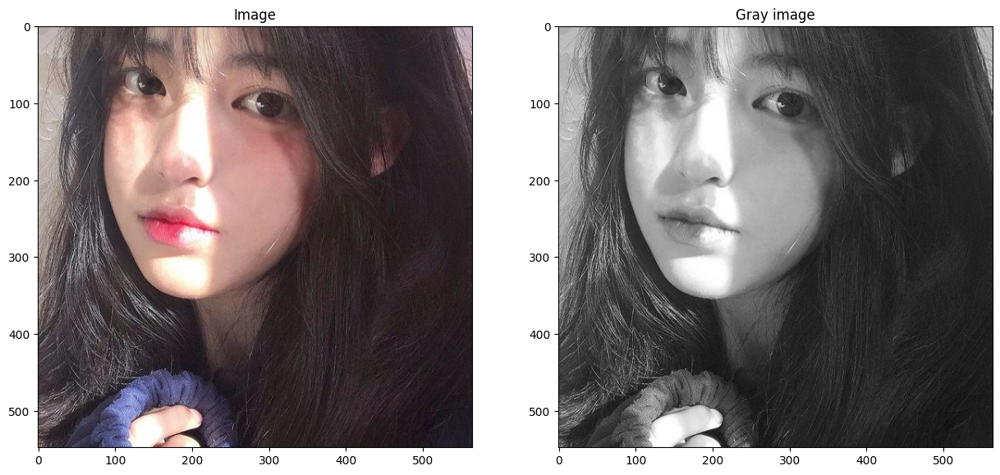

In [11]:
img = plt.imread('images/girl6.jpg')
img_gray = gray(img)
imshows([img, img_gray], titles=['Image', 'Gray image'])

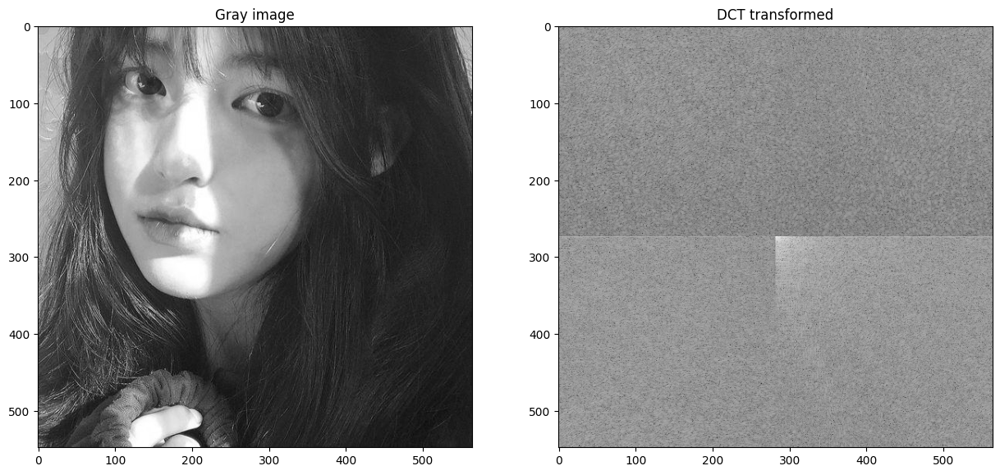

In [12]:
# DCT
def dct_transform(img):
    dct = cv2.dct(np.float32(img))
    dct_shift = np.fft.fftshift(dct)
    return np.log(np.abs(dct_shift))

dct = cv2.dct(np.float32(img_gray))
dct_shift = np.fft.fftshift(dct)

imshows([img_gray, dct_transform(img_gray)], 
	titles=['Gray image', 'DCT transformed'])

In [13]:
# Image Quality Metrics: PSNR vs. SSIM
# https://ieeexplore.ieee.org/document/5596999

# Why not use MSE?
# => Mean Squared Error: Love It or Leave It?: A new look at signal fidelity measures
# https://ece.uwaterloo.ca/~z70wang/publications/SPM09.pdf
from skimage.metrics import (
    peak_signal_noise_ratio as psnr, 
    structural_similarity as ssim
)

def metric(img, test, name:str=''):
    """Print PSNR and SSIM metric"""
    if name:
        print(f'Comparision between image and {name}')
    print(f'  - PSNR: {psnr(img, test, data_range=test.max() - test.min()):.2f}')
    print(f'  - SSIM: {ssim(img, test, data_range=test.max() - test.min()):.2f}')

Keeping only 5.00% of the DCT coefficients


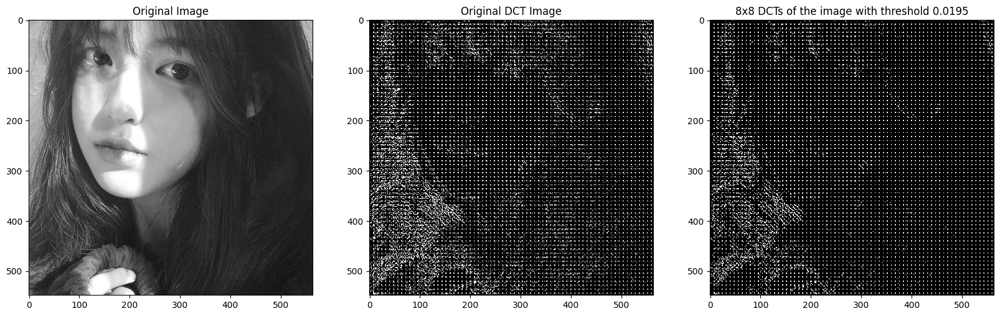

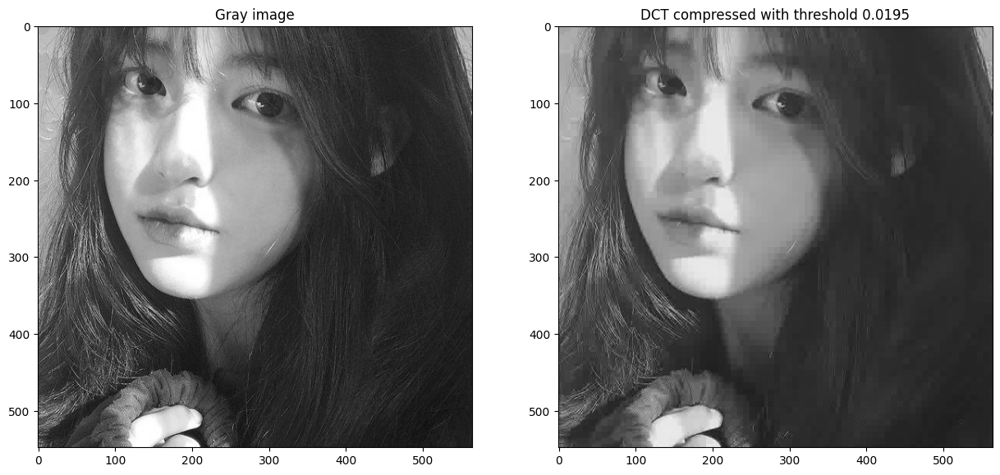

In [14]:
import scipy

def dct2(img):
    return scipy.fft.dct(
        scipy.fft.dct(img, axis=0, norm='ortho' ), axis=1, norm='ortho')

def idct2(img):
    return scipy.fft.idct(
        scipy.fft.idct(img, axis=0, norm='ortho'), axis=1 , norm='ortho')

imsize = img_gray.shape
dct = np.zeros(imsize)

# 8x8 DCT
for i in np.r_[:imsize[0]:8]:
    for j in np.r_[:imsize[1]:8]:
        dct[i:i+8, j:j+8] = dct2(img_gray[i:i+8, j:j+8])

# Threshold
thresh_dct = 0.0195
dct_thresh = dct * (abs(dct) > (thresh_dct*np.max(dct)))

plt.figure(figsize=(20,10))
plt.subplot(1,3,1)
plt.imshow(img_gray, cmap='gray')
plt.title("Original Image")
plt.subplot(1,3,2)
plt.imshow(dct, cmap='gray',vmax=np.max(dct)*0.01, vmin=0)
plt.title( "Original DCT Image")
plt.subplot(1,3,3)
plt.imshow(dct_thresh, cmap='gray',vmax=np.max(dct)*0.01, vmin=0)
plt.title(f'8x8 DCTs of the image with threshold {thresh_dct}')

percent_nonzeros_dct = np.sum(dct_thresh != 0.0) / (imsize[0]*imsize[1]*1.0)
print(f"Keeping only {percent_nonzeros_dct*100.0:.2f}% of the DCT coefficients")

img_dct = np.zeros(imsize)
for i in np.r_[:imsize[0]:8]:
    for j in np.r_[:imsize[1]:8]:
        img_dct[i:i+8, j:j+8] = idct2(dct_thresh[i:i+8, j:j+8])

imshows([img_gray, img_dct], 
        ['Gray image', f'DCT compressed with threshold {thresh_dct}'])

In [15]:
metric(img_gray, img_dct, 'DCT compressed')

Comparision between image and DCT compressed
  - PSNR: 30.91
  - SSIM: 0.79


## Image enhanced using DCT

### RGB

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


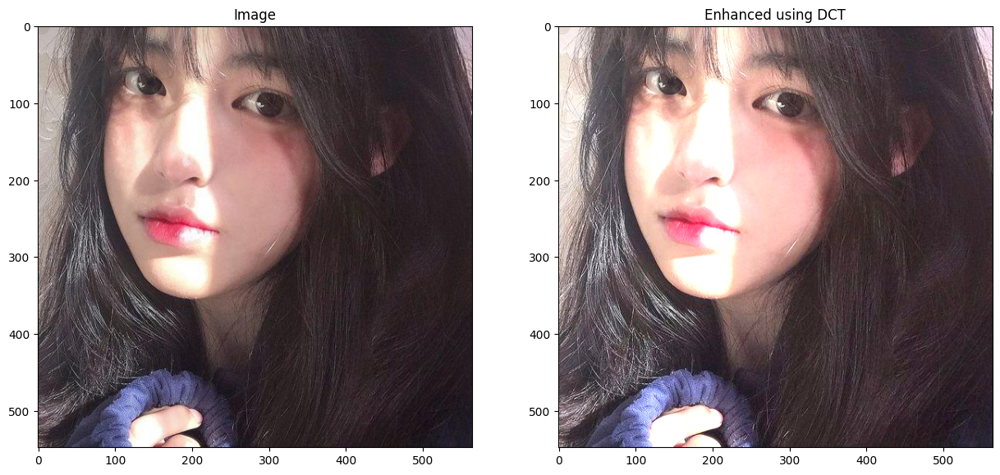

In [16]:
enhanced_channel = []
for channel in cv2.split(img):
    dct = cv2.dct(np.float32(channel))
    enhanced_dct = dct * 1.3
    enhanced = cv2.idct(enhanced_dct)
    enhanced_channel.append(enhanced.astype(int))

imshows([img, cv2.merge(enhanced_channel)], 
        titles=['Image', 'Enhanced using DCT'])

### HSV

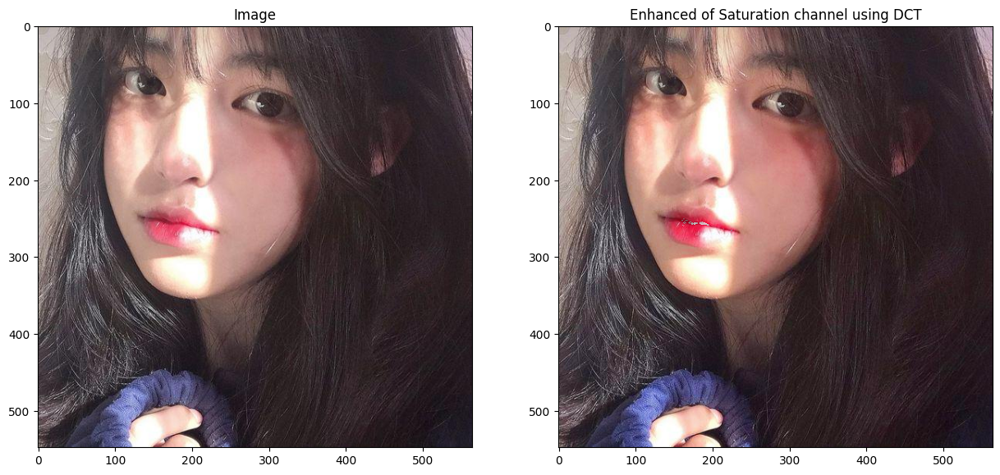

In [17]:
# https://rxian2.web.illinois.edu/cs445/proj1/
H, S, V = cv2.split(hsv(img))

dct = cv2.dct(np.float32(S))
enhanced_dct = dct * 1.25
enhanced_S = cv2.idct(enhanced_dct).astype(np.uint8)
enhanced_hsv = cv2.cvtColor(cv2.merge([H, enhanced_S, V]), cv2.COLOR_HSV2RGB)

imshows([img, enhanced_hsv],
        titles=['Image', 'Enhanced of Saturation channel using DCT'])

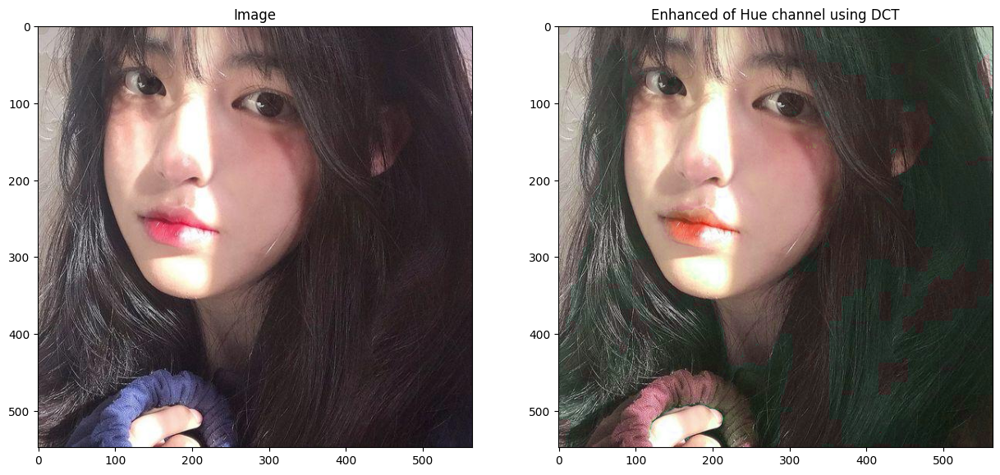

In [18]:
H, S, V = cv2.split(hsv(img))

dct = cv2.dct(np.float32(H))
enhanced_dct = dct * 1.5
enhanced_H = cv2.idct(enhanced_dct).astype(np.uint8)
enhanced_hsv = cv2.cvtColor(cv2.merge([enhanced_H, S, V]), cv2.COLOR_HSV2RGB)

imshows([img, enhanced_hsv],
        titles=['Image', 'Enhanced of Hue channel using DCT'])

# Bài 3

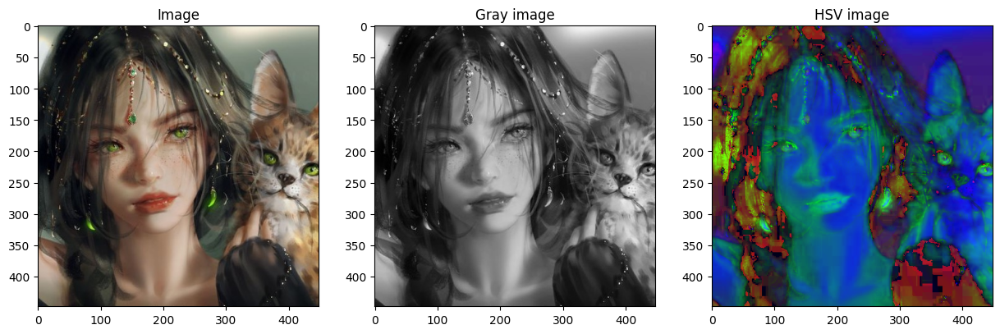

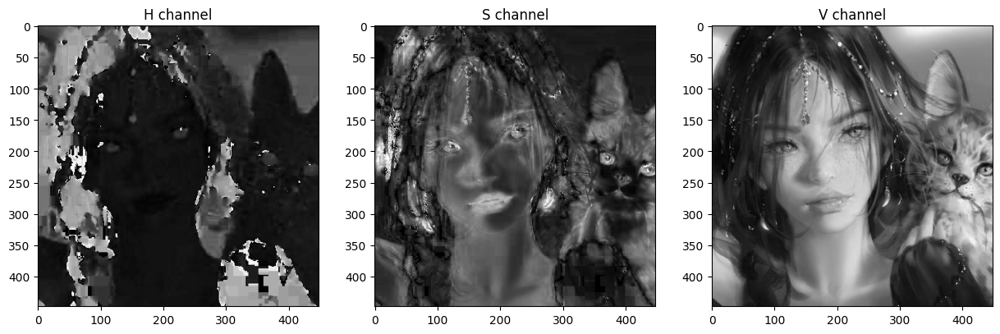

In [19]:
img_name = 'wlop2.jpg'
img_path = f'images/{img_name}'
img = plt.imread(img_path)
img_gray = gray(img)
img_hsv = hsv(img)
imshows([img, img_gray, img_hsv], titles=['Image', 'Gray image', 'HSV image'])

H, S, V = cv2.split(img_hsv)
imshows([H, S, V], [f'{channel} channel' for channel in ['H', 'S', 'V']])

In [20]:
def hsv2rgb(img_hsv):
    """Convert HSV image to RGB image"""
    return cv2.cvtColor(img_hsv, cv2.COLOR_HSV2RGB)

Compress **V channel**

Keeping only 4.97% of the DCT coefficients
Keeping only 5.01% of the DFT coefficients


C:\Users\LENOVO\AppData\Local\Temp\ipykernel_2752\249754422.py:47: ComplexWarning: Casting complex values to real discards the imaginary part
  dft_compressed_hsv = cv2.merge([H, S, img_dft.astype(np.uint8)])


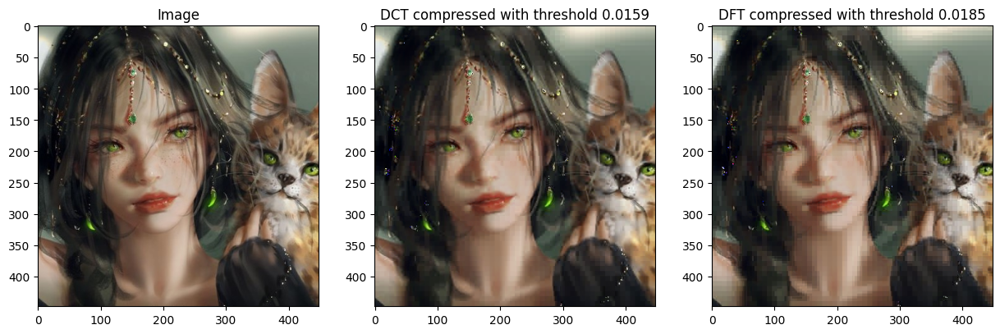

In [21]:
imsize = img_gray.shape

# DCT
dct = np.zeros(imsize)

# 8x8 DCT
for i in np.r_[:imsize[0]:8]:
    for j in np.r_[:imsize[1]:8]:
        dct[i:i+8, j:j+8] = dct2(V[i:i+8, j:j+8])

thresh_dct = 0.0159
dct_thresh = dct * (abs(dct) > (thresh_dct*np.max(dct)))

percent_nonzeros_dct = np.sum(dct_thresh != 0.0) / (imsize[0]*imsize[1]*1.0)
print(f"Keeping only {percent_nonzeros_dct*100.0:.2f}% of the DCT coefficients")

img_dct = np.zeros(imsize)
for i in np.r_[:imsize[0]:8]:
    for j in np.r_[:imsize[1]:8]:
        img_dct[i:i+8, j:j+8] = idct2(dct_thresh[i:i+8, j:j+8])

dct_compressed_hsv = cv2.merge([H, S, img_dct.astype(np.uint8)])
dct_compressed_rgb = hsv2rgb(dct_compressed_hsv)


# DFT
dft = np.zeros(imsize, dtype='complex')
img_dft = np.zeros(imsize, dtype='complex')

# 8x8 DFT
for i in np.r_[:imsize[0]:8]:
    for j in np.r_[:imsize[1]:8]:
        dft[i:i+8, j:j+8] = np.fft.fft2(V[i:i+8, j:j+8])

thresh_dft = 0.0185
dft_thresh = dft * (abs(dft) > (thresh_dft*np.max(abs(dft))))

percent_nonzeros_dft = np.sum(dft_thresh != 0.0) / (imsize[0]*imsize[1]*1.0)
print(f"Keeping only {percent_nonzeros_dft*100.0:.2f}% of the DFT coefficients")

# 8x8 iDFT
for i in np.r_[:imsize[0]:8]:
    for j in np.r_[:imsize[1]:8]:
        img_dft[i:i+8, j:j+8] = np.fft.ifft2(dft_thresh[i:i+8, j:j+8])
        

dft_compressed_hsv = cv2.merge([H, S, img_dft.astype(np.uint8)])
dft_compressed_rgb = hsv2rgb(dft_compressed_hsv)

imshows([img, dct_compressed_rgb, dft_compressed_rgb], 
        ['Image', 
         f'DCT compressed with threshold {thresh_dct}', 
         f'DFT compressed with threshold {thresh_dft}'])

In [22]:
from pathlib import Path
from skimage.io import imsave

def save(img, name, output_folder=Path('Saved_image/')):
    if not output_folder.exists():
        output_folder.mkdir()
    imsave(output_folder/name, img)

def get_image_size(img_path: str):
    """Get image file size from path"""
    from os.path import getsize
    bytes = getsize(img_path)
    kilobytes = bytes / 1024
    return kilobytes

# https://en.wikipedia.org/wiki/Data_compression_ratio
def compression_ratio(compressed_size, uncompressed_size):
    return uncompressed_size / compressed_size

def space_saving(compressed_size, uncompressed_size):
    return 1 - compressed_size/uncompressed_size

In [23]:
metric(img_gray, gray(dct_compressed_rgb), 'DCT compressed gray image')
metric(img_gray, gray(dft_compressed_rgb), 'DFT compressed gray image')

Comparision between image and DCT compressed gray image
  - PSNR: 31.14
  - SSIM: 0.90
Comparision between image and DFT compressed gray image
  - PSNR: 29.62
  - SSIM: 0.83


In [24]:
img_size = get_image_size(img_path)

dct_filename = 'DCT_compressed.jpg'
save(dct_compressed_rgb, dct_filename)
dct_compressed_size = get_image_size(f'Saved_image/{dct_filename}')

dft_filename = 'DFT_compressed.jpg'
save(dft_compressed_rgb, dft_filename)
dft_compressed_size = get_image_size(f'Saved_image/{dft_filename}')

print(f'Size of {img_name}: {img_size:.2f} kb')
print(f'Size of {dct_filename}: {dct_compressed_size:.2f} kb')
print(f'Size of {dft_filename}: {dft_compressed_size:.2f} kb')

Size of wlop2.jpg: 78.74 kb
Size of DCT_compressed.jpg: 18.57 kb
Size of DFT_compressed.jpg: 19.63 kb


In [25]:
print('Compression ratio of')
print(f'- DCT compressed: {compression_ratio(dct_compressed_size, img_size):.2f}')
print(f'- DFT compressed: {compression_ratio(dft_compressed_size, img_size):.2f}')

Compression ratio of
- DCT compressed: 4.24
- DFT compressed: 4.01


In [26]:
percent_space_saved_dct = space_saving(dct_compressed_size, img_size) * 100
print(f'DCT compressed size reduce {img_size - dct_compressed_size:.2f} kb from original image, save {percent_space_saved_dct:.2f}% space')

percent_space_saved_dft = space_saving(dft_compressed_size, img_size) * 100
print(f'DFT compressed size reduce {img_size - dft_compressed_size:.2f} kb from original image, save {percent_space_saved_dft:.2f}% space')

DCT compressed size reduce 60.17 kb from original image, save 76.42% space
DFT compressed size reduce 59.11 kb from original image, save 75.07% space


$\Rightarrow$ DCT compression cho ra kết quả tốt hơn so với DFT compression: 
DCT compression có metric SSIM lớn hơn DFT do đó **giống với ảnh gốc hơn**, 
**dung lượng ảnh sau khi nén nhỏ hơn** (tiết kiệm bộ nhớ hơn) dung lượng ảnh sau khi nén bằng DFT.

## Compression for S and H channel

Compress **S channel**

Keeping only 5.11% of the DCT coefficients


Keeping only 4.97% of the DFT coefficients


C:\Users\LENOVO\AppData\Local\Temp\ipykernel_2752\3784450167.py:47: ComplexWarning: Casting complex values to real discards the imaginary part
  dft_compressed_hsv = cv2.merge([H, img_dft.astype(np.uint8), V])


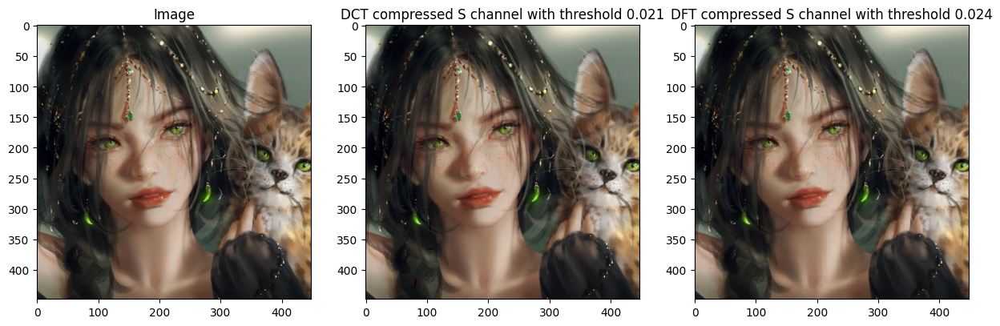

Comparision between image and DCT compressed gray image
  - PSNR: 43.12
  - SSIM: 0.99
Comparision between image and DFT compressed gray image
  - PSNR: 42.04
  - SSIM: 0.99
Size of wlop2.jpg: 78.74 kb
Size of DCT_S_compressed.jpg: 27.37 kb
Size of DFT_S_compressed.jpg: 27.31 kb
DCT compressed size reduce 51.36 kb from original image, save 65.24% space
DFT compressed size reduce 51.43 kb from original image, save 65.32% space


In [27]:
imsize = img_gray.shape

# DCT
dct = np.zeros(imsize)

# 8x8 DCT
for i in np.r_[:imsize[0]:8]:
    for j in np.r_[:imsize[1]:8]:
        dct[i:i+8, j:j+8] = dct2(S[i:i+8, j:j+8])

thresh_dct = 0.021
dct_thresh = dct * (abs(dct) > (thresh_dct*np.max(dct)))

percent_nonzeros_dct = np.sum(dct_thresh != 0.0) / (imsize[0]*imsize[1]*1.0)
print(f"Keeping only {percent_nonzeros_dct*100.0:.2f}% of the DCT coefficients")

img_dct = np.zeros(imsize)
for i in np.r_[:imsize[0]:8]:
    for j in np.r_[:imsize[1]:8]:
        img_dct[i:i+8, j:j+8] = idct2(dct_thresh[i:i+8, j:j+8])

dct_compressed_hsv = cv2.merge([H, img_dct.astype(np.uint8), V])
dct_compressed_rgb = hsv2rgb(dct_compressed_hsv)


# DFT
dft = np.zeros(imsize, dtype='complex')
img_dft = np.zeros(imsize, dtype='complex')

# 8x8 DFT
for i in np.r_[:imsize[0]:8]:
    for j in np.r_[:imsize[1]:8]:
        dft[i:i+8, j:j+8] = np.fft.fft2(S[i:i+8, j:j+8])

thresh_dft = 0.024
dft_thresh = dft * (abs(dft) > (thresh_dft*np.max(abs(dft))))

percent_nonzeros_dft = np.sum(dft_thresh != 0.0) / (imsize[0]*imsize[1]*1.0)
print(f"Keeping only {percent_nonzeros_dft*100.0:.2f}% of the DFT coefficients")

# 8x8 iDFT
for i in np.r_[:imsize[0]:8]:
    for j in np.r_[:imsize[1]:8]:
        img_dft[i:i+8, j:j+8] = np.fft.ifft2(dft_thresh[i:i+8, j:j+8])
        

dft_compressed_hsv = cv2.merge([H, img_dft.astype(np.uint8), V])
dft_compressed_rgb = hsv2rgb(dft_compressed_hsv)

imshows([img, dct_compressed_rgb, dft_compressed_rgb], 
        ['Image', 
         f'DCT compressed S channel with threshold {thresh_dct}', 
         f'DFT compressed S channel with threshold {thresh_dft}'])

metric(img_gray, gray(dct_compressed_rgb), 'DCT compressed gray image')
metric(img_gray, gray(dft_compressed_rgb), 'DFT compressed gray image')

dct_filename = 'DCT_S_compressed.jpg'
save(dct_compressed_rgb, dct_filename)
dct_compressed_size = get_image_size(f'Saved_image/{dct_filename}')

dft_filename = 'DFT_S_compressed.jpg'
save(dft_compressed_rgb, dft_filename)
dft_compressed_size = get_image_size(f'Saved_image/{dft_filename}')

print(f'Size of {img_name}: {img_size:.2f} kb')
print(f'Size of {dct_filename}: {dct_compressed_size:.2f} kb')
print(f'Size of {dft_filename}: {dft_compressed_size:.2f} kb')

percent_space_saved_dct = space_saving(dct_compressed_size, img_size) * 100
print(f'DCT compressed size reduce {img_size - dct_compressed_size:.2f} kb from original image, save {percent_space_saved_dct:.2f}% space')

percent_space_saved_dft = space_saving(dft_compressed_size, img_size) * 100
print(f'DFT compressed size reduce {img_size - dft_compressed_size:.2f} kb from original image, save {percent_space_saved_dft:.2f}% space')

Compress **H channel**

Keeping only 4.96% of the DCT coefficients
Keeping only 4.97% of the DFT coefficients


C:\Users\LENOVO\AppData\Local\Temp\ipykernel_2752\1208008527.py:47: ComplexWarning: Casting complex values to real discards the imaginary part
  dft_compressed_hsv = cv2.merge([img_dft.astype(np.uint8), S, V])


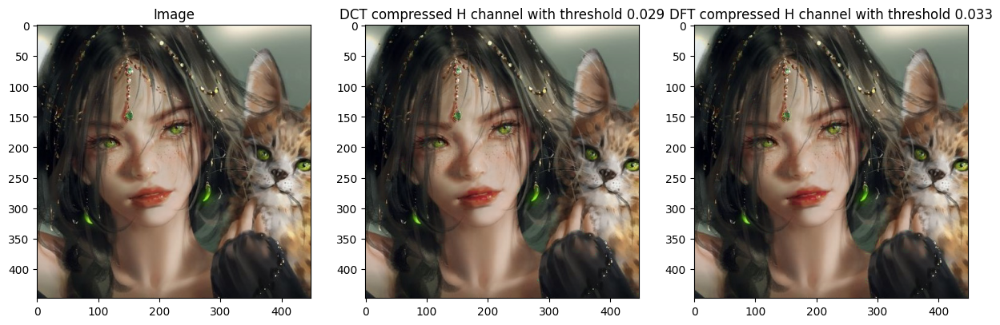

Comparision between image and DCT compressed gray image
  - PSNR: 45.61
  - SSIM: 1.00
Comparision between image and DFT compressed gray image
  - PSNR: 44.77
  - SSIM: 0.99
Size of wlop2.jpg: 78.74 kb
Size of DCT_H_compressed.jpg: 27.99 kb
Size of DFT_H_compressed.jpg: 27.98 kb
DCT compressed size reduce 50.74 kb from original image, save 64.45% space
DFT compressed size reduce 50.75 kb from original image, save 64.46% space


In [28]:
imsize = img_gray.shape

# DCT
dct = np.zeros(imsize)

# 8x8 DCT
for i in np.r_[:imsize[0]:8]:
    for j in np.r_[:imsize[1]:8]:
        dct[i:i+8, j:j+8] = dct2(H[i:i+8, j:j+8])

thresh_dct = 0.029
dct_thresh = dct * (abs(dct) > (thresh_dct*np.max(dct)))

percent_nonzeros_dct = np.sum(dct_thresh != 0.0) / (imsize[0]*imsize[1]*1.0)
print(f"Keeping only {percent_nonzeros_dct*100.0:.2f}% of the DCT coefficients")

img_dct = np.zeros(imsize)
for i in np.r_[:imsize[0]:8]:
    for j in np.r_[:imsize[1]:8]:
        img_dct[i:i+8, j:j+8] = idct2(dct_thresh[i:i+8, j:j+8])

dct_compressed_hsv = cv2.merge([img_dct.astype(np.uint8), S, V])
dct_compressed_rgb = hsv2rgb(dct_compressed_hsv)


# DFT
dft = np.zeros(imsize, dtype='complex')
img_dft = np.zeros(imsize, dtype='complex')

# 8x8 DFT
for i in np.r_[:imsize[0]:8]:
    for j in np.r_[:imsize[1]:8]:
        dft[i:i+8, j:j+8] = np.fft.fft2(H[i:i+8, j:j+8])

thresh_dft = 0.033
dft_thresh = dft * (abs(dft) > (thresh_dft*np.max(abs(dft))))

percent_nonzeros_dft = np.sum(dft_thresh != 0.0) / (imsize[0]*imsize[1]*1.0)
print(f"Keeping only {percent_nonzeros_dft*100.0:.2f}% of the DFT coefficients")

# 8x8 iDFT
for i in np.r_[:imsize[0]:8]:
    for j in np.r_[:imsize[1]:8]:
        img_dft[i:i+8, j:j+8] = np.fft.ifft2(dft_thresh[i:i+8, j:j+8])
        

dft_compressed_hsv = cv2.merge([img_dft.astype(np.uint8), S, V])
dft_compressed_rgb = hsv2rgb(dft_compressed_hsv)

imshows([img, dct_compressed_rgb, dft_compressed_rgb], 
        ['Image', 
         f'DCT compressed H channel with threshold {thresh_dct}', 
         f'DFT compressed H channel with threshold {thresh_dft}'])

metric(img_gray, gray(dct_compressed_rgb), 'DCT compressed gray image')
metric(img_gray, gray(dft_compressed_rgb), 'DFT compressed gray image')

dct_filename = 'DCT_H_compressed.jpg'
save(dct_compressed_rgb, dct_filename)
dct_compressed_size = get_image_size(f'Saved_image/{dct_filename}')

dft_filename = 'DFT_H_compressed.jpg'
save(dft_compressed_rgb, dft_filename)
dft_compressed_size = get_image_size(f'Saved_image/{dft_filename}')

print(f'Size of {img_name}: {img_size:.2f} kb')
print(f'Size of {dct_filename}: {dct_compressed_size:.2f} kb')
print(f'Size of {dft_filename}: {dft_compressed_size:.2f} kb')

percent_space_saved_dct = space_saving(dct_compressed_size, img_size) * 100
print(f'DCT compressed size reduce {img_size - dct_compressed_size:.2f} kb from original image, save {percent_space_saved_dct:.2f}% space')

percent_space_saved_dft = space_saving(dft_compressed_size, img_size) * 100
print(f'DFT compressed size reduce {img_size - dft_compressed_size:.2f} kb from original image, save {percent_space_saved_dft:.2f}% space')

$\Rightarrow$ Nén kênh màu Hue (H) và Saturation (S) bằng DCT hay DFT đều trả ra kết quả gần như giống với ảnh gốc (**SSIM >= 0.99**). Giảm được khoảng **65% bộ nhớ** so với ảnh gốc.

## SVD compression

Rank of image: 448
Size of wlop2.jpg: 78.74 kb
---
Size of SVD_compressed_10.jpg: 20.43 kb, save 74.05% space
PSNR: 22.85, SSIM: 0.64
---
Size of SVD_compressed_50.jpg: 28.42 kb, save 63.90% space
PSNR: 28.46, SSIM: 0.86
---
Size of SVD_compressed_100.jpg: 30.05 kb, save 61.83% space
PSNR: 30.42, SSIM: 0.93
---
Size of SVD_compressed_250.jpg: 28.10 kb, save 64.31% space
PSNR: 41.17, SSIM: 0.99
---
Size of SVD_compressed_400.jpg: 27.56 kb, save 65.00% space
PSNR: 51.20, SSIM: 1.00
---


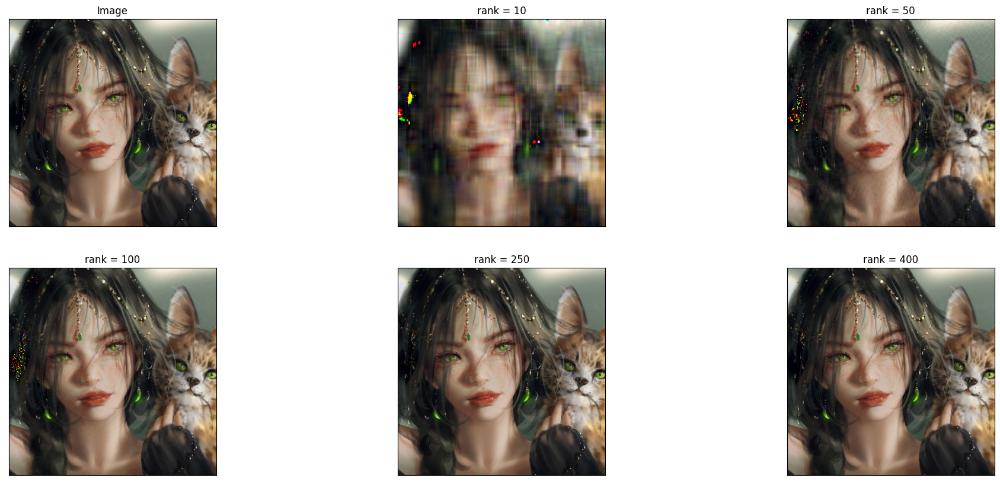

In [29]:
# http://timbaumann.info/svd-image-compression-demo/
def SVD_compression(U, S, V, r):
    """SVD compression"""
    
    assert r > 0, 'Invalid input r, r must be greater than 0'
    return np.dot(U[:, :r], np.dot(np.diag(S[:r]), V[:r, :]))

rank = np.linalg.matrix_rank(img_gray)
print(f'Rank of image: {rank}')
print(f'Size of {img_name}: {img_size:.2f} kb\n---')

img_list = [img]
titles = ['Image']
ranks = [10, 50, 100, 250, 400]
for r in ranks:
    compressed = []
    for channel in cv2.split(img):
        U, S, V = np.linalg.svd(channel)
        compressed.append(SVD_compression(U, S, V, r).astype(np.uint8))

    compressed_img = cv2.merge(compressed)
    img_list.append(compressed_img)

    file_name = f'SVD_compressed_{r}.jpg'
    titles.append(f'rank = {r}')

    save(compressed_img, file_name)
    compressed_size = get_image_size(f'Saved_image/{file_name}')

    print(f'Size of {file_name}: {compressed_size:.2f} kb, save {space_saving(compressed_size, img_size) * 100:.2f}% space')
    print(f'PSNR: {psnr(img_gray, gray(compressed_img)):.2f}, SSIM: {ssim(img_gray, gray(compressed_img)):.2f}')
    print('---')

imshows(
    img_list, titles=titles, clean=True, size=(2, 3)
)

Ta thấy với rank = 400, kết quả của SVD compression cho ra kết quả giống với ảnh gốc (SSIM = 1) và giúp tiết kiệm 65% dung lượng so với ảnh gốc.